<a href="https://colab.research.google.com/github/viveknittmca/Scaler/blob/main/Notes_LinearRegression_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Content

- **Univariate Linear Regression using Scikit Learn**

- **Multivariate Linear Regression**

- **Adjusted R-square**

- **Model Interpretibility and Feature Importance**

- **Assumptions of Linear Regression**



### Introduction to Use case

- Let's continue with our Cars24 price prediction problem.
- We are given with various features such as age of car, odometer reading, model of car etc.
- First objective is to understand the task. Our task is to **predict the resale price of the car.**
- Resale price is numeric.

#### Question: Are we doing classification or regression?
Ans: Since we have to predict continuous numeric value, we are doing regression task,



### Univariate LR using Scikit Learn

#### Previously Done

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

!gdown 1fLuRn7BLw_Mz_AbzAaYVt3D336RSRRvK

Downloading...
From: https://drive.google.com/uc?id=1fLuRn7BLw_Mz_AbzAaYVt3D336RSRRvK
To: /content/cars24-car-price-clean.csv
100% 4.19M/4.19M [00:00<00:00, 173MB/s]


In [ ]:
df = pd.read_csv('cars24-car-price-clean.csv')
df.head()

,selling_price,year,km_driven,mileage,engine,max_power,age,make,model,Individual,Trustmark Dealer,Diesel,Electric,LPG,Petrol,Manual,5,>5
0,0.043684,0.689655,0.031553,0.135345,0.117891,0.066506,0.310345,0.184371,0.042522,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0
1,0.252397,0.827586,0.005237,0.128448,0.177281,0.123994,0.172414,0.207231,0.225975,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0
2,0.089795,0.620690,0.015764,0.112069,0.177281,0.120773,0.379310,0.207231,0.120277,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0
3,0.095134,0.689655,0.009711,0.145862,0.147808,0.100000,0.310345,0.184371,0.093549,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0
4,0.262104,0.793103,0.007869,0.161810,0.221860,0.150709,0.206897,0.224624,0.300085,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0


In [ ]:
# define X and y
X = df["model"].values
Y = df["selling_price"].values

# standardize the data
u = X.mean()
std = X.std()
X = (X-u)/std

In [ ]:
def r2_score(Y,Y_hat):
    num = np.sum((Y-Y_hat)**2)
    denom = np.sum((Y- Y.mean())**2)
    score = (1 - num/denom)
    return score

#### Scikit-learn
- Though we have already implemented Linear Regression model from scratch,
- We have a library which does it for us and provides key insights such as weights of the model, performance of the model.

- Link For  [linear Regression using Scikit-learn](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html)

In [ ]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
type(model)

sklearn.linear_model._base.LinearRegression

- Notice how ```model``` is just an object of Linear Regression Class
- Recall when implementing from scratch, how we used ```gradent_descent()``` for X number of epochs to train our Linear Regression model



####**How to train the model using LinearRegression class?**
- Scikit-learn provides an inbulit [fit](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html#sklearn.linear_model.LinearRegression.fit) method to train the model



In [ ]:
model.fit(X,Y)

ValueError: ignored

- But when we used fit method on our X and Y, it gave a shape error

#### **Why was there shape error when using fit method?**
- the documentation for fit method says:
  - X (array-like, sparse matrix) of shape (n_samples,n_features)
  - Y (array-like, sparse matrix) of shape (n_samples,) or (n_samples, n_features)

Lets check our X and Y:

In [ ]:
print(X.shape,Y.shape)

(19820,) (19820,)


- Notice how X and Y shapes are incompatible with the Scikit learn fit method




reshaping X, Y to the required shape

In [ ]:

X = X.reshape(X.size, 1)
Y = Y.reshape(Y.size, 1)

print(X.shape,Y.shape)

(19820, 1) (19820, 1)


Since now our Data is in required shape

- Now lets fit the model

In [ ]:
model.fit(X,Y)

LinearRegression()

Now that our model is trained,

#### How do we see the predictions of the trained **model** object?

In [ ]:
y_hat = model.predict(X)

print('Predicted')
print(y_hat[:3])
print('Actual')
print(Y[:3])

Predicted
[[0.04949638]
 [0.22942491]
 [0.12575748]]
Actual
[[0.04368402]
 [0.25239655]
 [0.08979493]]


#### What are the learnt parameters?

In [ ]:
w0 = model.intercept_
w1 = model.coef_
print(w0, w1)

[0.30508475] [[0.22705189]]



- Notice how scikit-learn did all the implementation much quickly and with less code.

Lets see how our LR model performed

Visualising Predictions

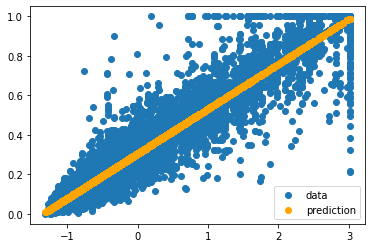

In [ ]:
fig = plt.figure()
plt.scatter(X,Y,label='data')
plt.scatter(X,y_hat,color='orange',label='prediction')
plt.legend()
plt.show()

#### How do we get the performance metric for our model?


```score``` Returns the coefficient of determination of the prediction ($R^2$)

In [ ]:
model.score(X,Y)

0.9313236629576507

- Notice how we got the similar $R^2$ value as when implemented from scratch
- Shows how Scikit-learn did the same things which we implemented but making the code simple

#### Does $R^2$ = 0.54, suggests our model good?
Ans: No, it means that our Univariate LR model just performed decent as compared to a mean model

### Multivariate Linear Regression

#### Code for Multivariate LR from Scratch


Lets consider all of the features of Cars24 data to predict the selling price

#### **What will be our Linear Regression model hypothesis?**
Before starting, let's simplify our notation a bit, let's define another variable
$x_0 = 1$ :

$h(x) = w_0x_0 + w_1x_1 + w_2x_2 ...... w_nx_n = ∑_{i=0}^{i=n} w_ix_i = W^TX   $

- Now, both $W$  and $X$  are vectors, and thus, dot product ```np.dot()``` can be used.

- Note that $W$  and $X$ are $n+1$  dimensional vectors, and $i$  ranges from $0 → n $.


In [ ]:
df.head()

,selling_price,year,km_driven,mileage,engine,max_power,age,make,model,Individual,Trustmark Dealer,Diesel,Electric,LPG,Petrol,Manual,5,>5
0,0.043684,0.689655,0.031553,0.135345,0.117891,0.066506,0.310345,0.184371,0.042522,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0
1,0.252397,0.827586,0.005237,0.128448,0.177281,0.123994,0.172414,0.207231,0.225975,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0
2,0.089795,0.620690,0.015764,0.112069,0.177281,0.120773,0.379310,0.207231,0.120277,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0
3,0.095134,0.689655,0.009711,0.145862,0.147808,0.100000,0.310345,0.184371,0.093549,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0
4,0.262104,0.793103,0.007869,0.161810,0.221860,0.150709,0.206897,0.224624,0.300085,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0


**Getting X and Y**
- Removing the selling price and taking rest of the features in X

In [ ]:
X = df[df.columns.drop('selling_price')]
Y = df["selling_price"]

Convert X and Y from dataframes to numpy array

In [ ]:
X = X.to_numpy()
Y = Y.to_numpy()

Standardization of Data
- Doing the same steps as before

In [ ]:
u = np.mean(X,axis=0)
std = np.std(X,axis=0)

X = (X-u)/std

In [ ]:
print(X.shape, Y.shape)

(19820, 17) (19820,)


**Adding $x_0$ feature to X**

In [ ]:
ones = np.ones((X.shape[0],1))
X = np.hstack((ones,X))

In [ ]:
print(X.shape)

(19820, 18)


#### Multivariate Linear Regression

In [ ]:
def hypothesis(X,weight):
    return np.dot(X,weight)

**Mean Squared Error**

#### **How does the Error Function change?**
No change in the function, earlier one data point was one feature, now one data point has multiple features. Use the same MSE loss function.

In [ ]:
def error(X,y,weight):
    e = 0.0
    m = X.shape[0]
    y_hat = hypothesis(X,weight)
    e = np.sum((y-y_hat)**2)
    return e/m

Gradient Calculation

#### How does the Gradient Descent change for multiple features?
- Lets first recall from gradient descent univariate topic




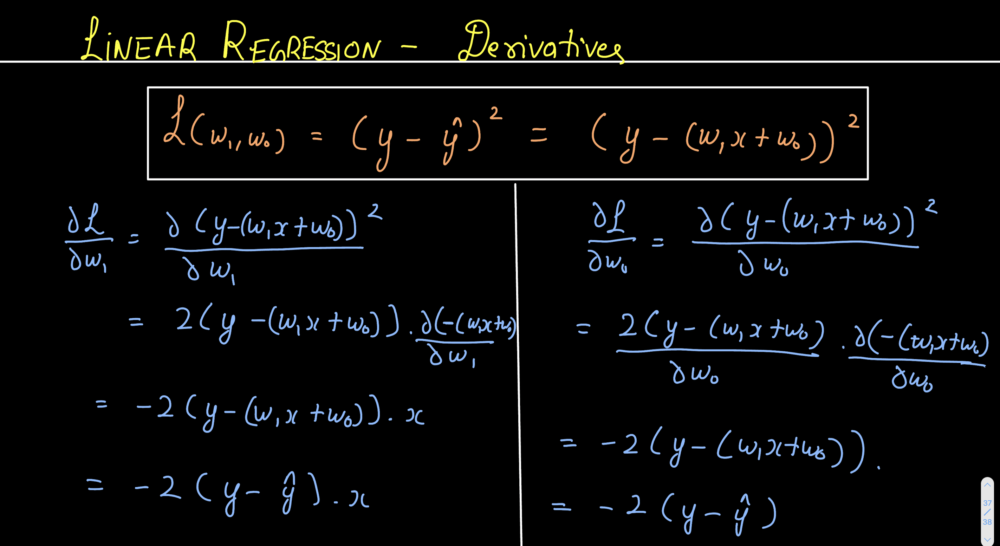

To calculate the gradients, we have to find partial derivatives of the los w.r.t various parameters w's.


$ \frac{∂J}{∂w_i} = \frac{1}{2m} \frac{\partial ∑_{i=1}^{i=m}(y_i-h(x_i))^2 }{∂w_i} $

Where
  - m is the number of samples
  - h(x) is the hypothesis function defined as :
  $ ∑_{i=0}^{i=n} w_ix_i $

Notice, we used the same equation for calculation derivatives w.r.t w0 and w1.


Now, lets generalise this for any $w_i$

Taking the $\partial$ under the summation
  - Equation now becomes:
    - $ \frac{∂J}{∂w_i} = \frac{1}{2m} ∑_{i=1}^{i=m} \frac{\partial (y_i-h(x_i))^2 }{∂w_i} $

Recall from calculas, if $y=u^2$, then $\frac{dy}{du} = 2u$
- now equation becomes:
    - $ \frac{∂J}{∂w_i} = \frac{1}{2m} ∑_{i=1}^{i=m}2(y_i-h(x_i)) \frac{\partial (y_i-h(x_i)) }{∂w_i} $

Since $h(x) = ∑_{i=0}^{i=n} w_ix_i $
  - Equation becomes:
    - $ \frac{∂J}{∂w_i} = \frac{1}{2m} ∑_{i=1}^{i=m}2(y_i-h(x_i)) \frac{\partial (y_i-∑ _{j=0}^{j=n}w_ix_i) }{∂w_i} $

If $ y = -au $, where a is a constant, then $\frac{dy}{du} = -a $
  - Equation becomes:

    - $ \frac{∂J}{∂w_i} = \frac{1}{2m} ∑_{i=1}^{i=m}2(y_i-h(x_i))(-x_i) $











In [ ]:
def gradient(X,y,weight):

    y_hat = hypothesis(X,weight)
    grad = np.dot(X.T,(y_hat - y))
    m = X.shape[0]
    return grad/m

def gradient_descent(X,y,learning_rate = 0.1,epochs=500):

    n = X.shape[1]
    weight = np.zeros((n,))
    error_list = []

    for i in range(epochs):
        e = error(X,y,weight)
        error_list.append(e)

        #Gradient descent
        grad = gradient(X,y,weight)
        weight = weight - learning_rate*grad

    return weight, error_list

In [ ]:
import time
start = time.time()
weight, error_list = gradient_descent(X,Y)
end = time.time()
print("Time taken is ", end-start)

Time taken is  0.3634607791900635


**What are the learnt parameters?**

In [ ]:
print(weight)

[ 0.30508475  0.01528358 -0.00430307 -0.01137388  0.0071149   0.00681522
 -0.01528358  0.01446966  0.18654218 -0.00398817 -0.00080921  0.00368586
  0.00301192  0.00070946 -0.00493635 -0.00308501 -0.00442518 -0.00615209]


**How does the error change during training?**


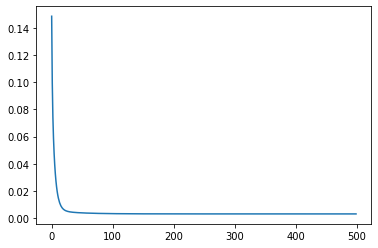

In [ ]:
fig = plt.figure()
plt.plot(error_list)
plt.show()

**What are predictions for X?**


In [ ]:
Y_hat = hypothesis(X,weight)

**How does the model perform ?**

In [ ]:
def r2_score(y,y_):
    num = np.sum((y-y_)**2)
    denom = np.sum((y- y.mean())**2)
    score = (1- num/denom)
    return score

In [ ]:
r2_score(Y,Y_hat)

0.9421852544960344

### Problems with R-squared, Adjusted R-squared

Imagine adding one extra feature/predictor to your model

And lets say that feature is not a good predictor example - third party infotainment system in a car

Of course, the trained model will assign very small weight to this fearture

#### But what do you think, what happens to R-squared as we add a feature?

Case1: Feature is a relevant predictor = R-sqauared will increase (trivial) \
Case2: Feature is not a  relevant predictor = ???

#### What do you it will decrease, increase or remain same?

It **would have decreased if model would start performing worse** by adding a feature

But model can just assign a small or zero weight to handle that case.

#### So, will it increase or remain same?

- In reality, both are possible.
- Sometimes, model starts making "spurious associations" during training
- It assigns some weights to irrelevant features and hence R-sqaured "increases a bit"

#### But what do we want? What is our final aim?

**Pick a complex model (with more features) only IF it actually improves the performance**

#### But why more features is a problem?

Remember, **no of samples (m) >> no of features (d)** for good training



Lets try to change the formula for R-squared a bit

Somehow, **we have to compare performance v/s model complexity (no. of features)**

Consider the equation $1 - [\frac{(1-R^2)(m-1)}{(m-d-1)}]$


**Case: d increases, but not significant changed in R-sq**


  - If d increases, (m-d-1) will decrease, $[\frac{(1-R^2)(m-1)}{(m-d-1)}]$ will increase
  - Since, there is no increase in $R^2$ due to performance gain, $1 - [\frac{(1-R^2)(m-1)}{(m-d-1)}]$ will decrease.

**Case: d increases but with significant changes in performance (R-sq)**

  - If d increases, (m-d-1) will decrease, $[\frac{(1-R^2)(m-1)}{(m-d-1)}]$ will increase
  - Since, there is there is an increase in $R^2$ due to performance gain, $ [\frac{(1-R^2)(m-1)}{(m-d-1)}]$ will decrease overall, and  $1 - [\frac{(1-R^2)(m-1)}{(m-d-1)}]$ will increase


This equation is called Adjusted R-squared.

Lets define it formally

#### Adjusted R-sqaured

The adjusted R-squared is a modified version of R-squared that adjusts for the number of predictors in a regression model. It is calculated as:

$ Adj R^2 = 1- [(1-R^2)\frac{(m-1)}{(m-d-1)} ]$

where:
- m: the number of samples
- d: the numner of features

In [ ]:
Adj_R = 1 - (1-r2_score(Y,Y_hat))*(len(Y)-1)/(len(Y)-X.shape[1]-1)
print("Adjusted R-squared:", Adj_R )

Adjusted R-squared: 0.9421326982908391


### Model Interpretibility and Feature Importance

Now that you've made the model. How do you make sense out of it ?

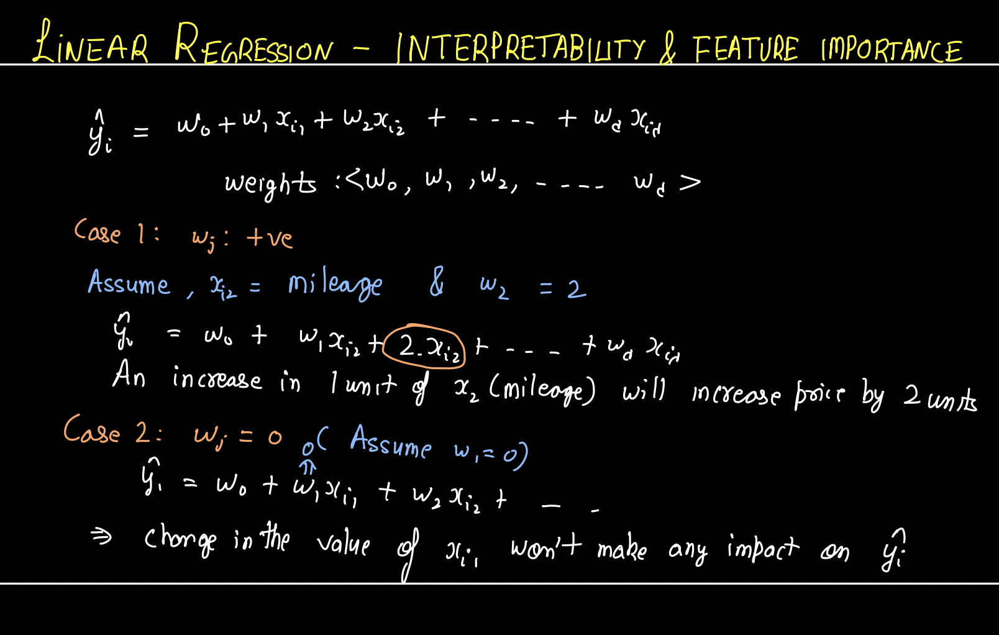

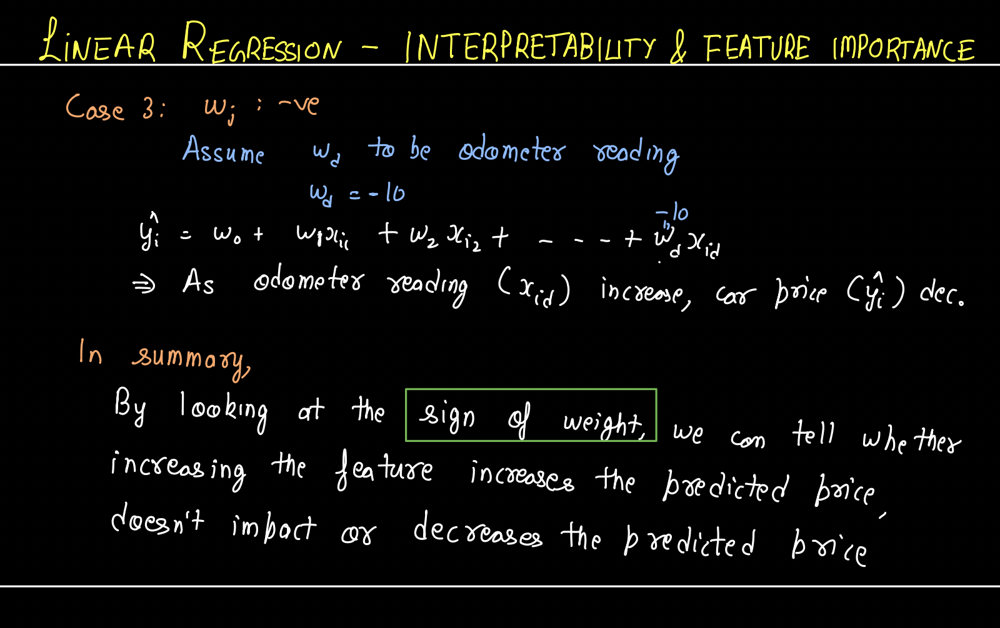

- Our model is `y_i_hat = w0 + w1xi1 + w2xi2 + .... + wdxid`
- w0, w1, ... wd are weights
- Let's assume we trained the model using the historical data and we got the weights
- We have weights corresponding to each of the feature fi
- Notation:
  - i -> to represent datapoint (xi - ith datapoint)
  - j -> to represent dimension (xij - jth dimension of ith datapoint)
- Weights are just coefficients
- `y_i_hat` is our predicted price


***

**First aspect**
- Now, **Case-1: wj is +ve**
  - What does it mean when wj is positive ?
  - Assume w2 is mileage and weight w2 corresponding to it is 2
  - If there is increase in mileage by 1 unit, the predicted price will increase by 2 units
  - An increase the feature will increase your y_i_hat

- **Case 2 : wj = 0**
  - When wj is 0, no matter how much the feature value changes, there will be no impact y_i_hat or predicted price value. (feature value * 0 = 0)

- **Case 3 : wj is -ve**
  - Assume wd is -10  and xid is odometer reading
  - As the odometer reading increases, the predicted price value will decrease (-10 * odometer reading)


- Just by looking at the sign of the weight, we can tell whether increasing the feature will increase the price/doesn't impact or decrease the predicted price.

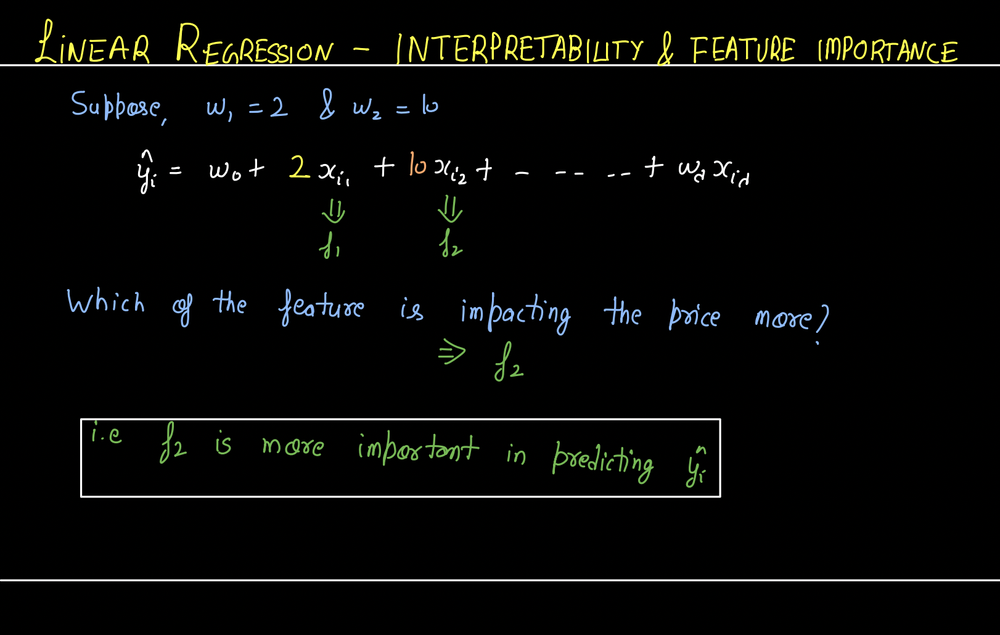

- **Second Aspect**
  - Suppose w1 is 2 and w2 is 10
  - As feature1 increases, predicted price increases.
  - As feature2 increases, predicted price also increases
  - But when feature1 increases by 1 unit, predicted price increases by 2 units. When feature2 increases by 1 unit, predicted price increases by 10 units.
  - **Which feature is impacting the price more ?** Obviously feature2.
  - So, feature2 is more important or contributes more in predicting the price.


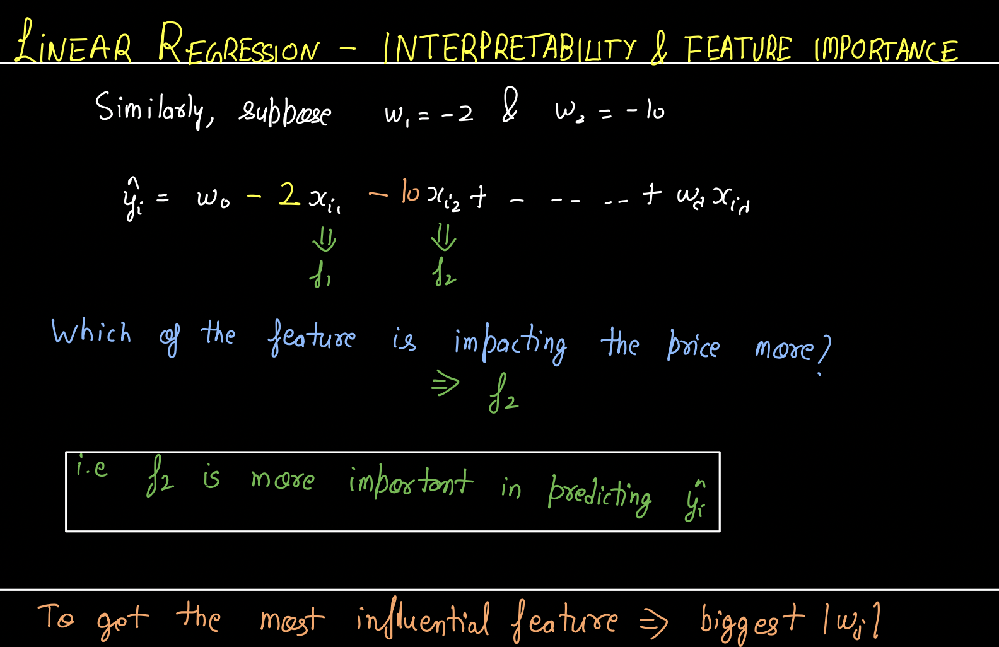

- Let's take exactly opposite example
- Assume w1 is -2 and w2 is -10
- In this case, if f1 increases by 1 unit, price reduces by 2 unit. Similarly, if f2 increases by 1 unit, price reduces by 10 units
- Even in this case, f2 is more important in predicting the price
- If we want most important or most influential feature, all i have to do is take absolute value of weights and get the largert weight.
- But there is an issue with this approach, let's look into it.

### **Issue with absolute weight approach**

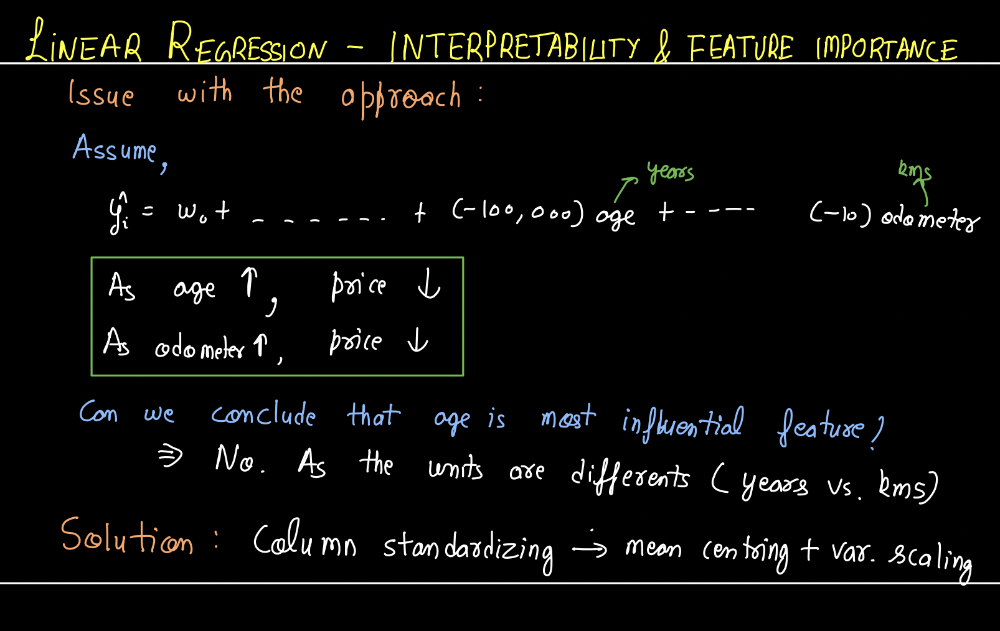

- Suppose `y_i_hat  - wo + ..... + (-100,000)*age + .... + (10)* odometer`.
- If age of car increases by 1 unit, the price drop by 100,000 units.
- If odometer reading increases by 1 unit, the price drops by 10 units.
- If we think that largest absolute value of weight creates most impact, we may conclude that age is the more influential feature than odometer.
- But age is measured in years and odometer is measured in kilometers.
- How can we compare age with kms ? We can't.
- Weights of features are function of units in which we have the data.
- **How do we solve this?** => **Standardize** the data
- For each feature, we do mean centering and variance scaling.

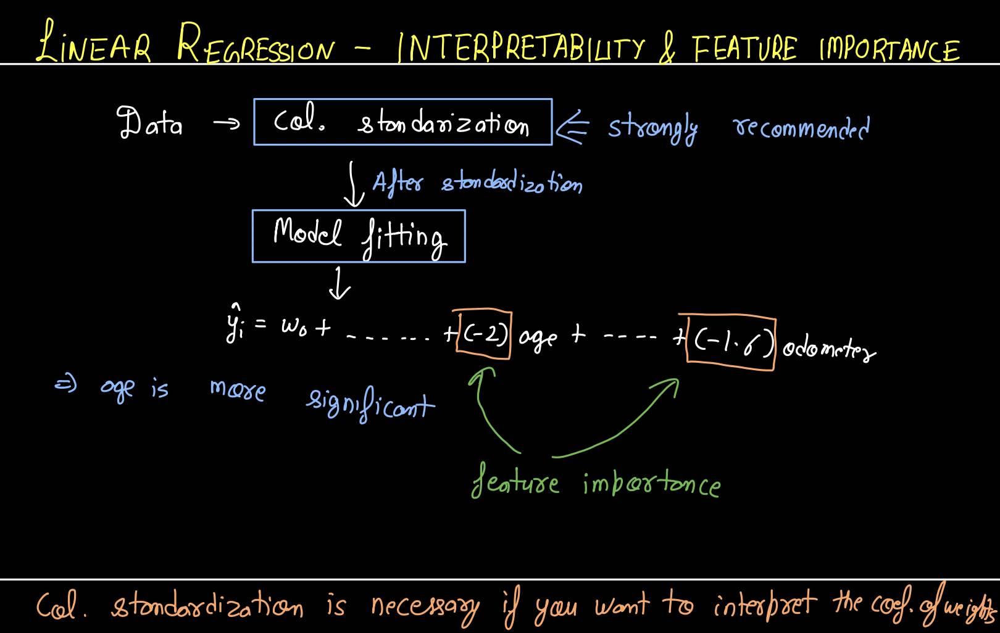

- Now, let's say we standardizated our data, fit a model on it and got our feature weights.
- Let's say feature coef of age is -2 and 1.6 for odometer.
- Now, can we compare the feature coef. ? Can we say age is more influential than odometer? Yes
- Column standardized is not mandatory but recommended
- If you want to interpret the coef. of weights for feature importance, we have to column standardize the data.
- If you don't standardize data, you can't compare weights with each other but each individual weight will tell you how it impacts the y_i_hat or predicted price in this case
- For example: Assume case where we did not standardize data if feature is age and weight is -100,000. Then weight coef is telling us that if age increases by 1 unit, price will decrease by 100,000 units.
- For feature importance, standardization is must
- For model interpretibility(how feature is impact predicted value), standardization isn't required.

Note: You standardize the data. You find the weights using optimization.

P.s - Standardization also makes sure GD behaves properly i.e. it converges fast.


#### Question: How do we standardize future unseen data ?

Ans: Use the mean and std dev of feature_j calculated using train time to standardize data at test time.

### Assumptions of Linear Regression

- We can arrive at concept of Linear regression in two ways
  - Algebra & Optimization (Geometric) - We covered this
  - Probability & Stats
- We can prove that Linear regression is a very good model if all the statistical assumptions holds true.


#### 1.Assumption of Linearity



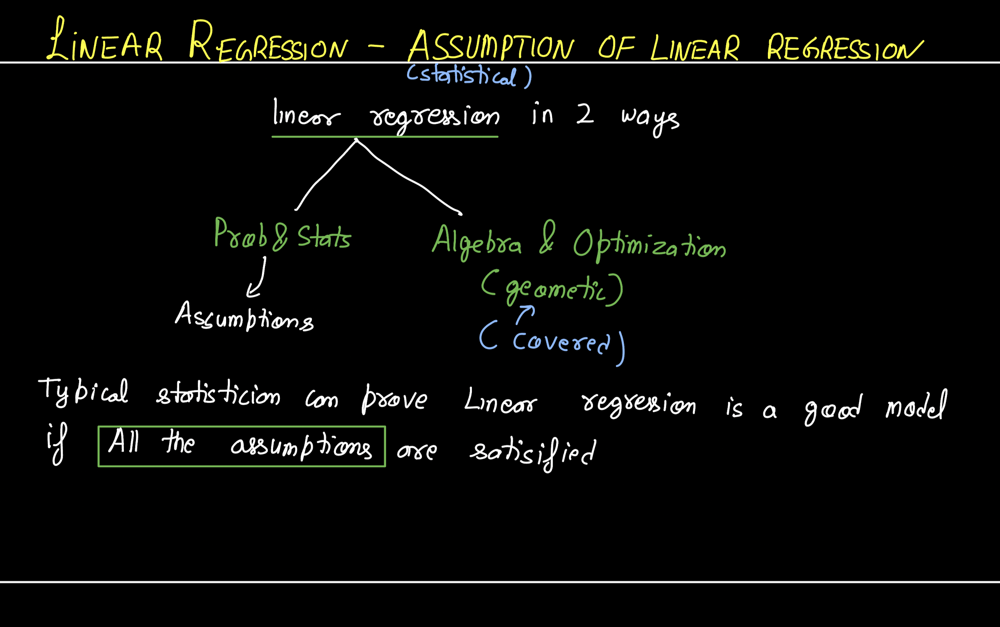

- There exists a linear function of d-dim s.t `y_i = f_linear(xi)`.
- There is a linear relationship or linear function such that if we give a point xi to it, it can predict yi.


#### 2.Features are not multi-collinear


**Collinearity**

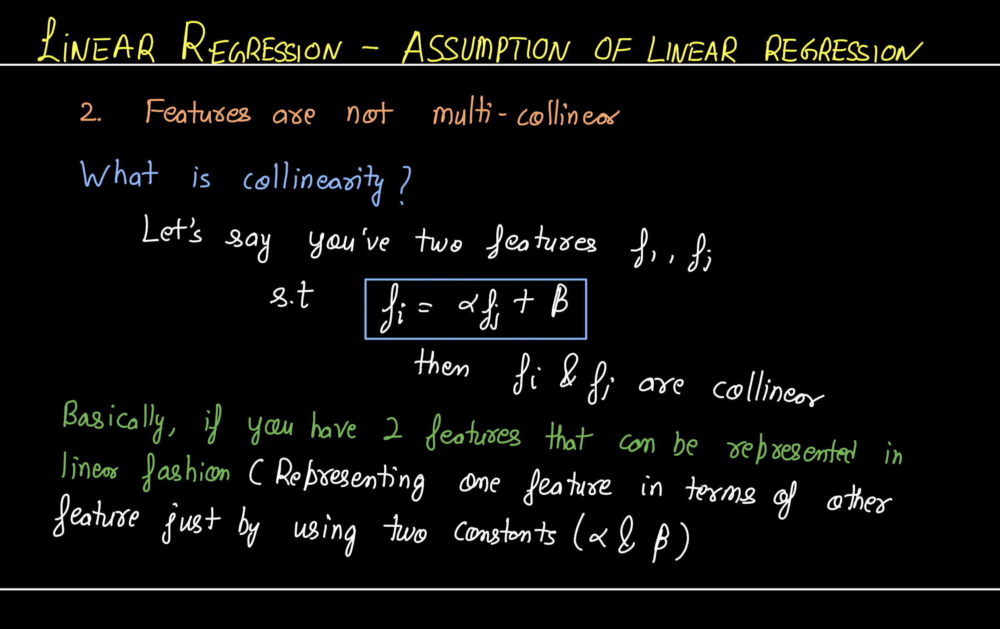

- Assume you've two features fi and fj such that fi can be represented as `a *fj + b`, then fi and fj are said to be collinear
- If you have two features which can be represented in linear fashion i.e representing one feature in terms of other feature just by using two constants (a and b)

**Multi-Collinearity**

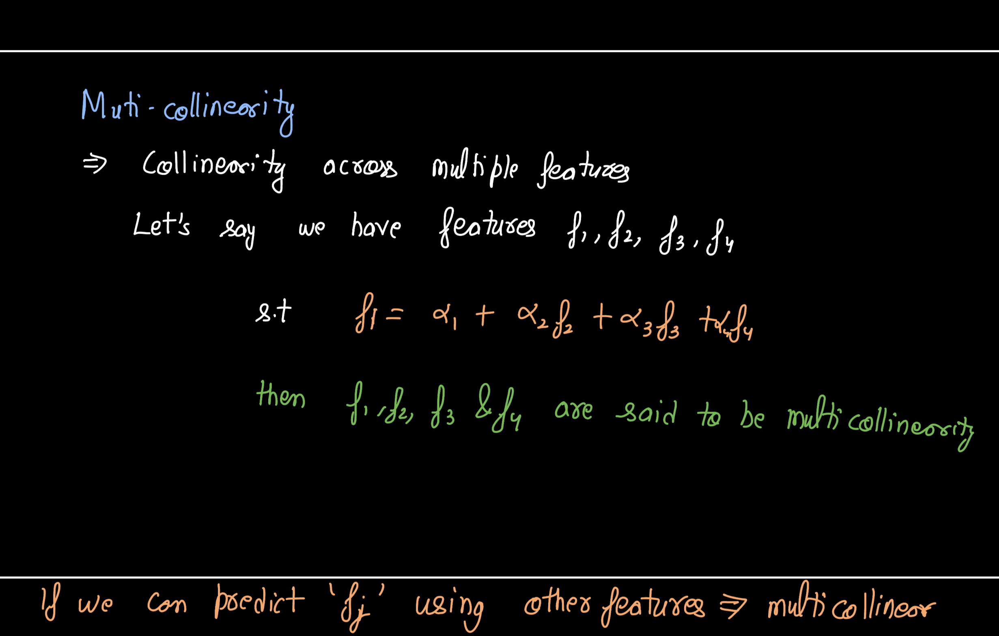

- Multicollinearity is defined as collinearity across multiple features
- If you have 4 features f1, f2, f3 and f4 and f1 can be represented using `a + b*f1 + c*f2 + d*f3`, then features are said to be multicollinear


**Why is multi-collinearity a problem?**

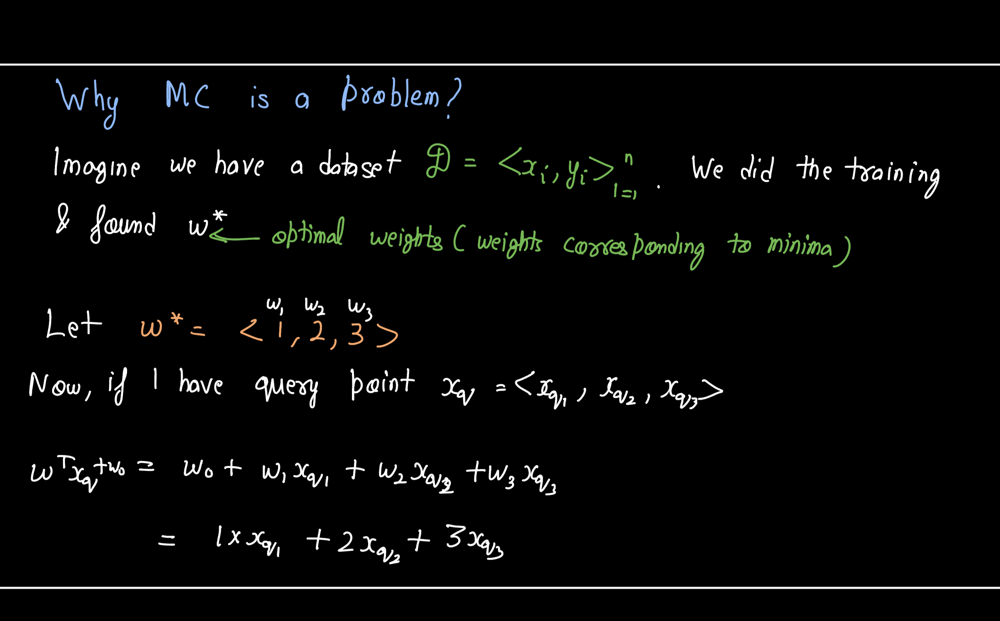

- Imagine you had a dataset which you trained you linear regression on.
- After training you got your optimal weights w*
- Let's say you have a query point xq during test time.
- Now, `y_hat= wT*xq + w0 = w0 + w1*xq1 + w2*xq2 + w3*xq3`
- y_hat = xq1 + 2*xq2 + 3*xq3 (as w* = <1,2,3>)  


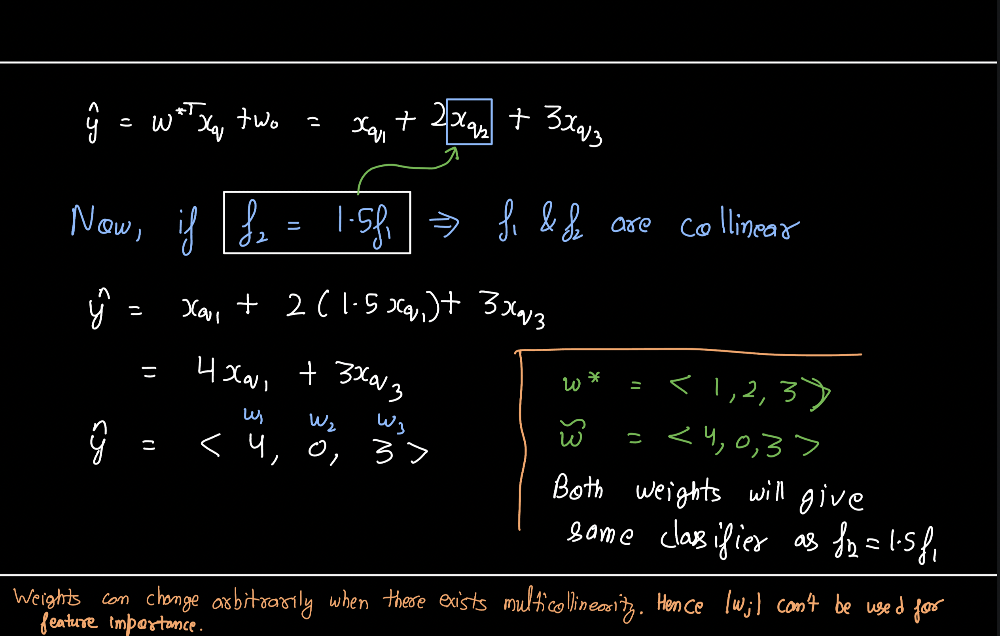

- Now, if f2 = 1.5*f1 i.e. f1 and f2 are collinear.
- Then, `y_hat = xq1 + 2(1.5*xq1) + 3*xq3 => 4*xq1 + 3*xq3`
- Weight vector becomes <4,0,3> i.e. both original and new weights will give the same classifier
- In multicollinearity, weight vector can change arbitrarily. Hence, absolute value of weight vector can't be used for feature importance.

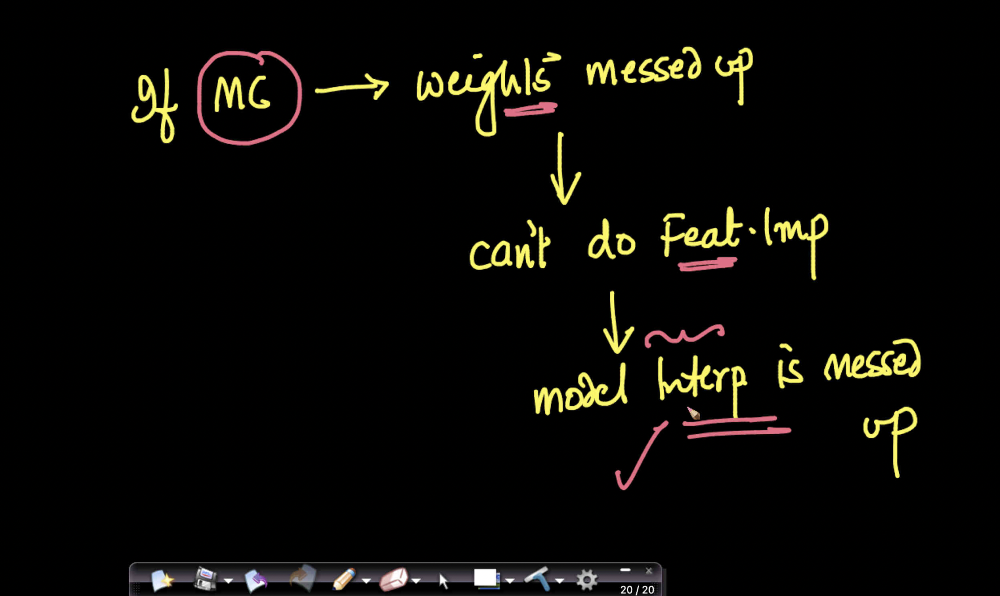

#### Question: Suppose we have two features f1 and f2 s.t f1 = log(f2). IS there a multi-collinearity in f1 and f2?
Ans: No. f1 and f2 are correlation but not multi-collinear as there is supposed to be linear function. log(x) is not linear function.

- Now that we understand Multi-Colinearity and its issues

#### How can we remove these highly correlated features?


#### VIF

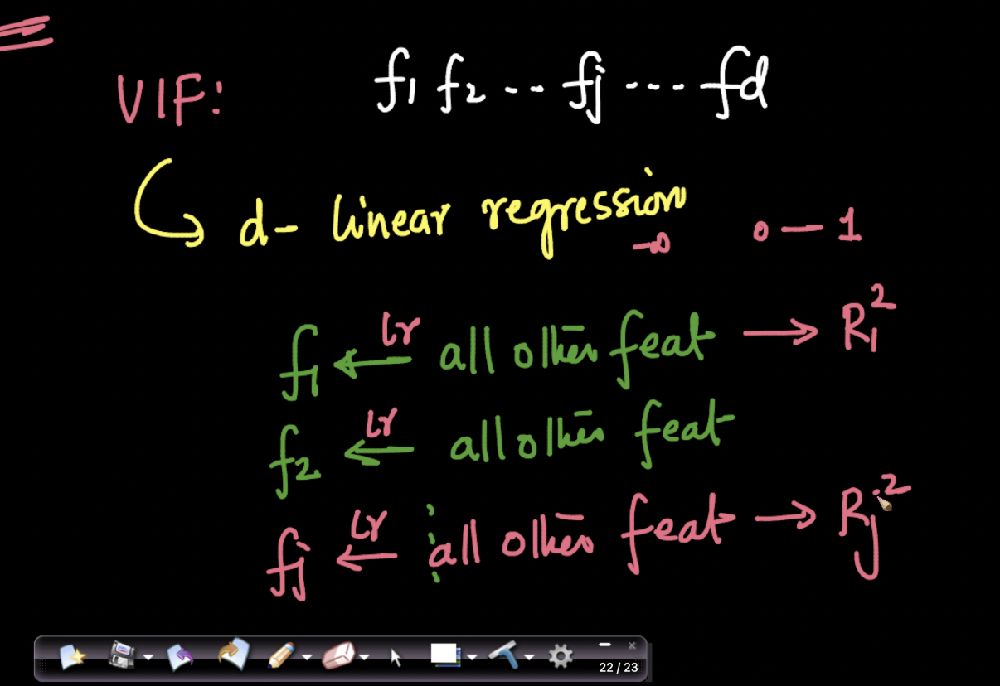

- If we had d features $(f_1,f_2,f_3....f_d)$
- we perform d-linear regression
- d means: d times linear regression model is performed

- So for a $j^{th}$ linear regresssion, we consider feature $f_j$ as our y
- And remaining d-1 features as our X
- We train our Linear Regression model
- and predict the $R_j^2$ metric

Lets take an example for better understanding

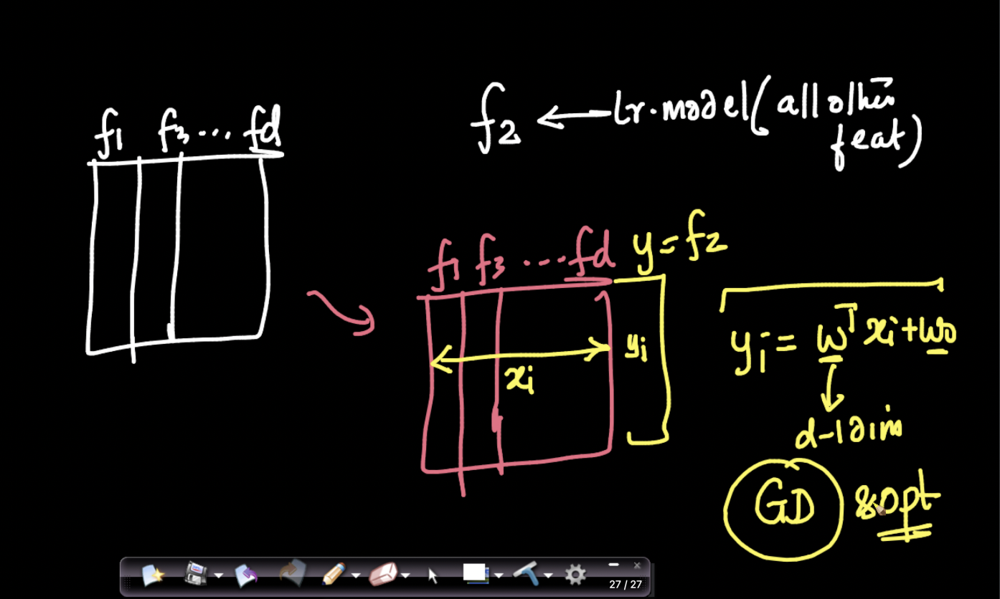

Supposedly we want to perform VIF for feature $f_2$
- We consider $f_2$ as our y
- the remaining d-1 features $(f_1,f_3,....,f_d)$ becomes our X
- We train a Linear Regression model for predicting $f_2$
  - $f2 = W^TX+W_0$
  - Perform Gradient Descent and Optimization
- Calculate $R^2$ Metric

#### What purpose does $R^2$ serves?
- Recall how $R^2$ measures how good our model performs and how a model is considered a best fit if $R^2$ is close to 1,
- so if we have $R^2$ value close to one, it means the feature $f2$ is collinear with the remaining features
- Hence $f_2$ can be removed.  

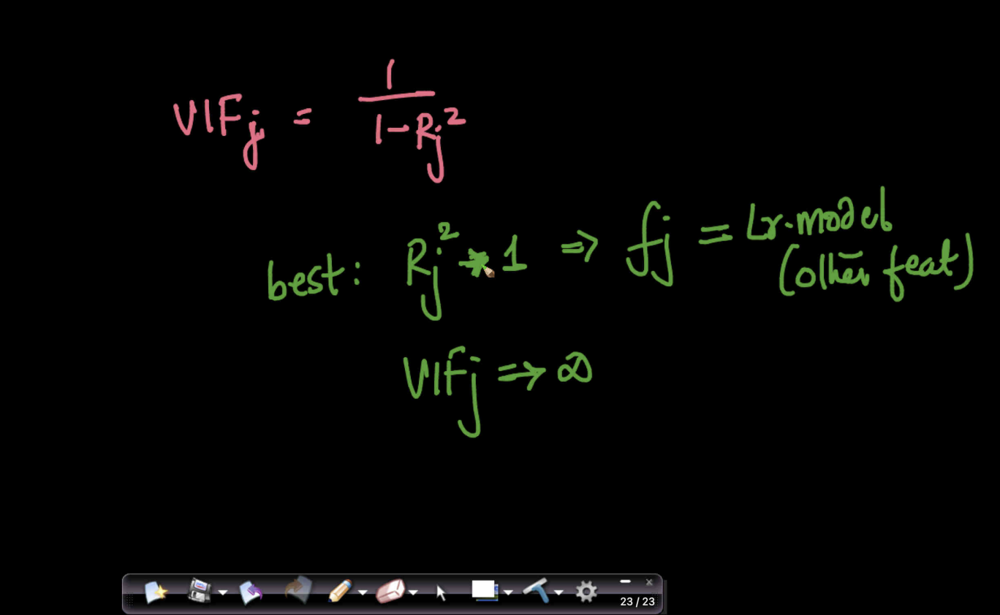

- We define VIF metric which is defined for feature $f_j$ as:
  - ${VIF}_j = \frac{1}{1-R_j^2}$
- For Best Linear Regression model, $R_j^2 = 1$,
- then ${VIF}_j = ∞$
- this means $f_j$ is highly multi-correlated with the remaining features and can be removed.


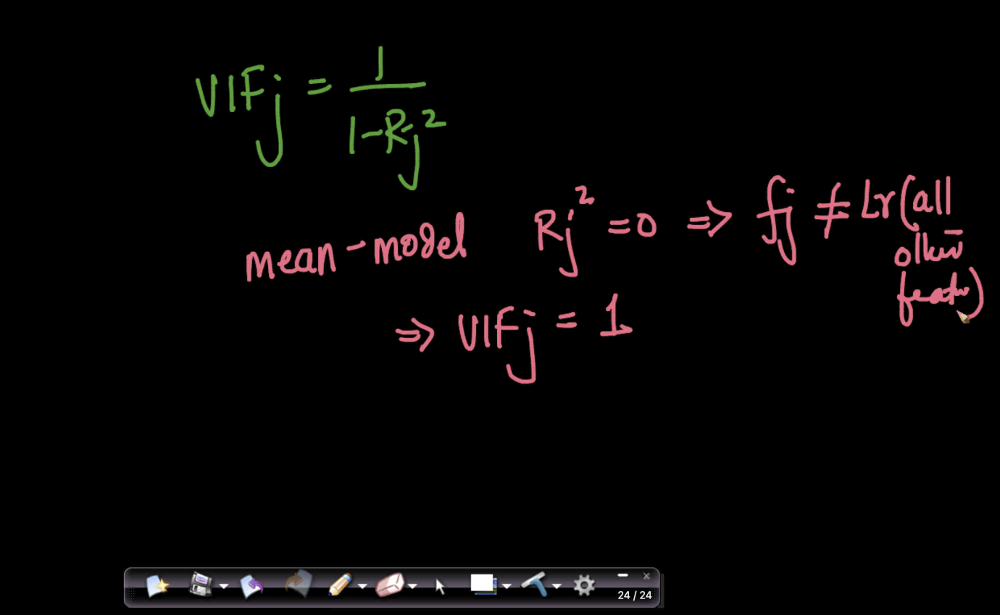

#### what if $R_j^2 = 0 $ ?
- recall how $R^2 = 0$ means only when Linear Regression model performed the same as the mean-model.
- This suggests feature $f_j$ has no multi collinearity with the other remianing d-1 features
- Here $VIF_j = 1$


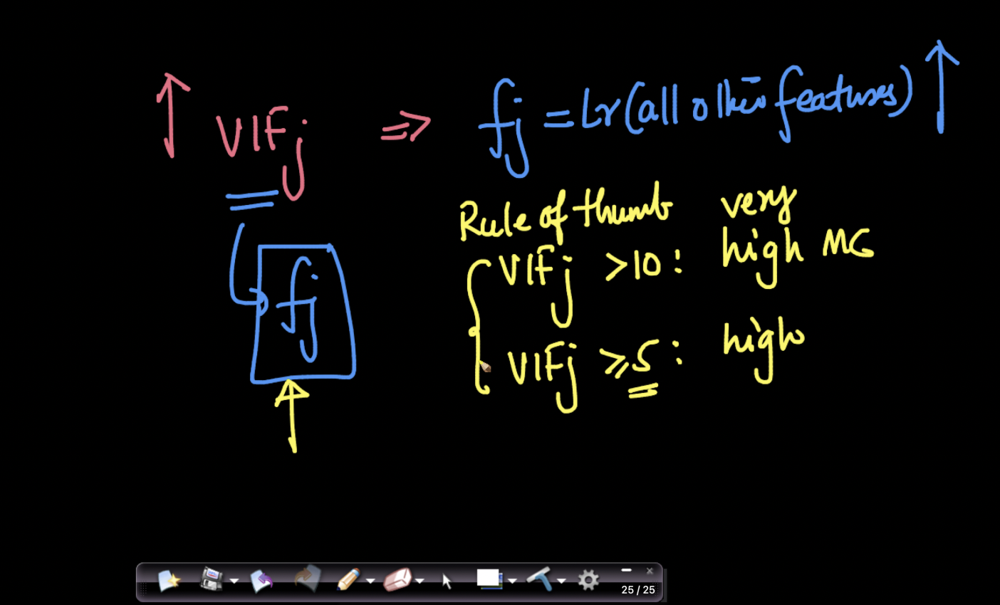

- It can be infered that if ${VIF}⇑$, that feature is more collinear
- Rule of thumb:
  - if $VIF_j > 10$ : Very High multiCollinearity
  - if 5 <= $VIF_j <10 $: High multiCollinearity

#### 3.Errors are normally distributed

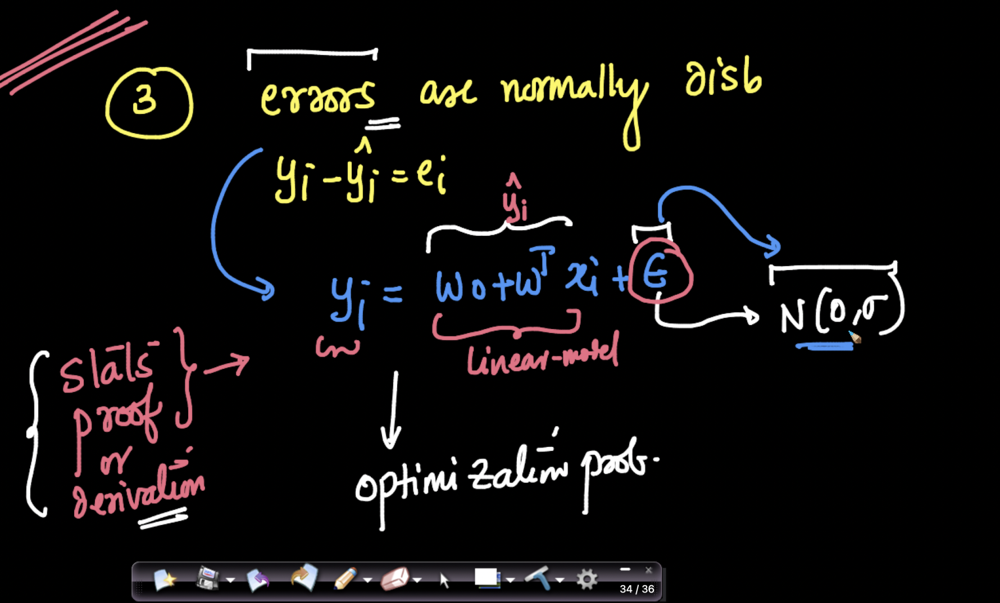

- Third assumption is: Errors (e_i) are normally distributed.
- e_i = yi - y_i_hat
- Fundamental assumption is y_i cannot be perfectly modeled using linear model and there is always going to be an error (epsilon).
- Epsilon (Error) follows normal distribution
- Using this assumption, we arrive at optimization problem in prob and stats.

**Practical Significance**

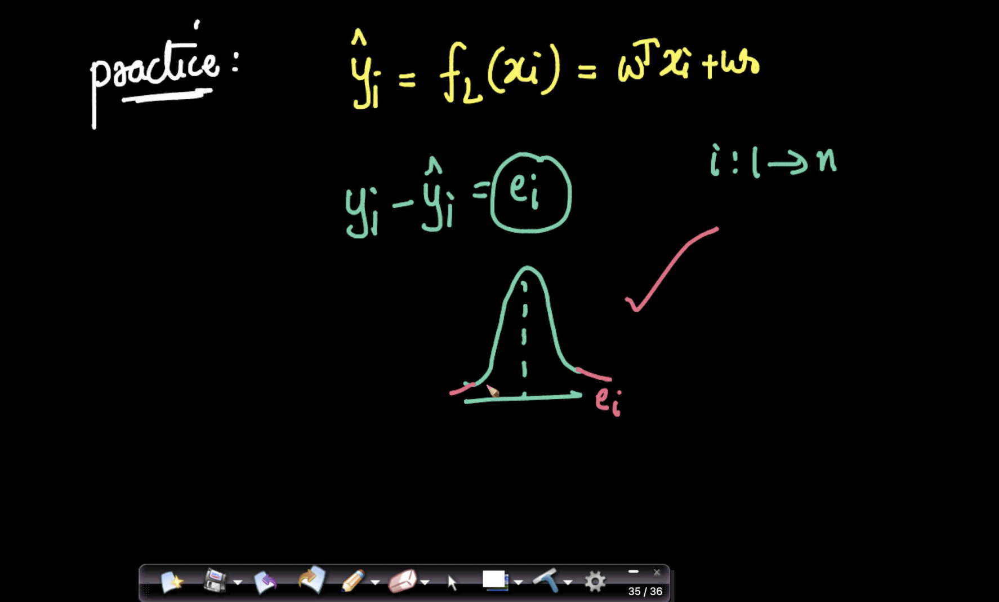

- How is it helpful in practice?
- We build a linear model which gives us `y_i_hat = f(xi) = wT.xi +w0`
-  We have our original yi.
- Errors ei = yi - y_i_hat (i : 1 -> n)
- We plot the distribution the errors. If the distribution of errors is gaussian distribution then the assumption is being sastified (sanity check)

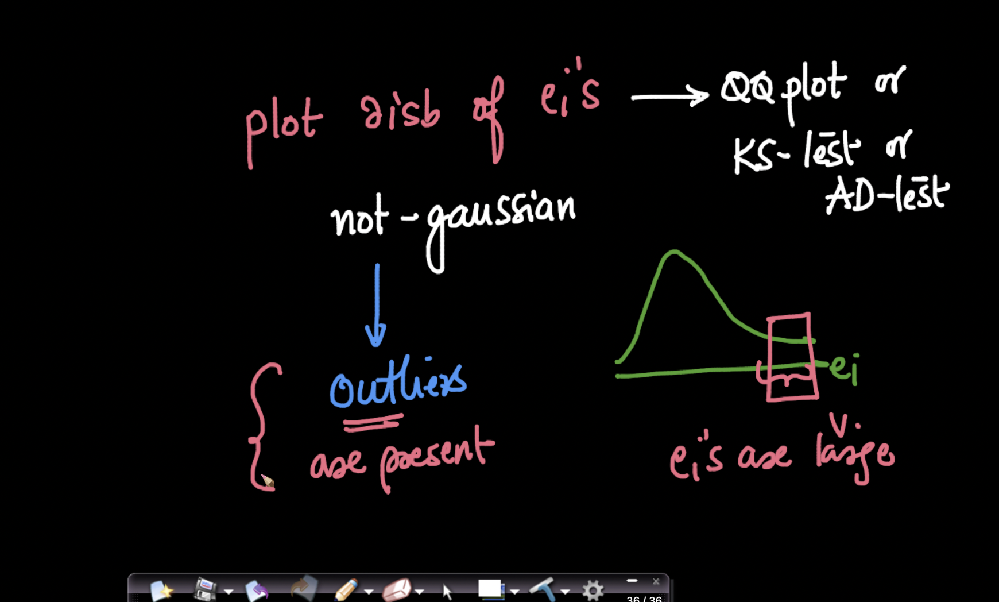

- If you plot the error distribution and it is not normal, then it means there are outliers present in data.
- It means there are some observations where the error is very large. i.e. likelyhood of outliers is more.

**Impact of outliers on Linear Regression**

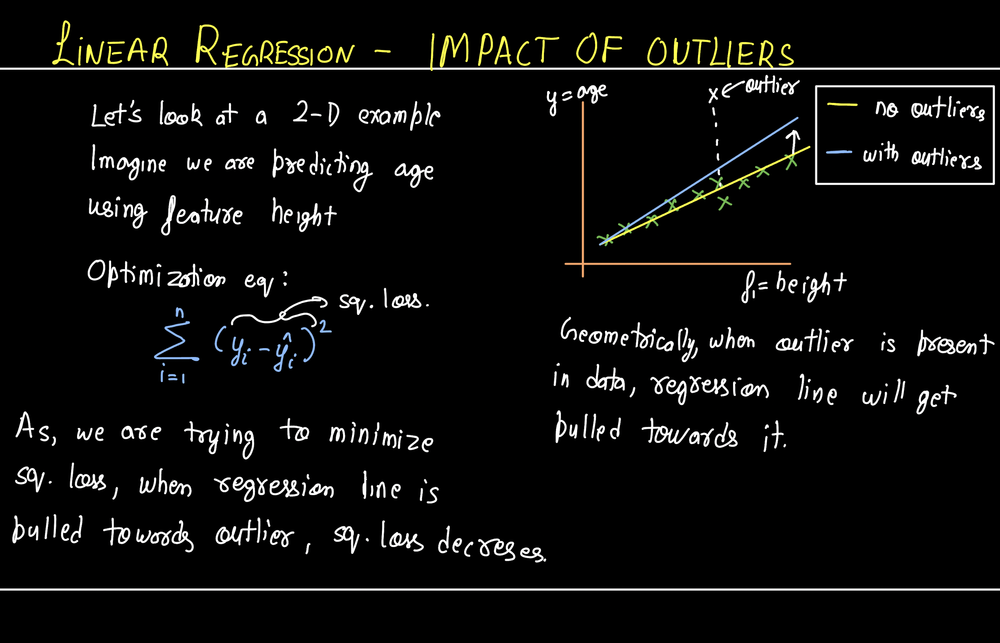

- Let's try to understand impact of outliers using a 2D example.
- Suppose you are trying to predict age using height.
- When outliers are not present, you get a good line of best fit.
- When there is an outlier present, the line of best fit or regression line will get pulled towards it.
- Why regression line is pulled towards outlier?
- Error is difference between actual and predicted value.
- The closer the regression line is to outlier, less the error. The goal is to get minimum squared error.

#### Question: After plotting the plot for errors, we see the curve is non-gaussian i.e. Outliers are present. How do we identify and remove these outlier?

Ans:

- Outliers will have large error value (yi - yi_hat).
- Remove the points will high error as many as you want and fit the model again.
- Check the distribtion of errors on new model and repeat.

Lets See how is the error distribution for Car24

In [ ]:
Y_hat = hypothesis(X,weight)
errors = Y_hat - Y

Text(0.5, 1.0, 'Histogram of residuals')

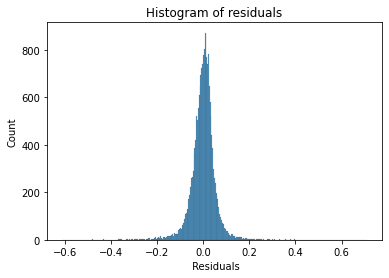

In [ ]:
import seaborn as sns

sns.histplot(errors)
plt.xlabel(" Residuals")
plt.title("Histogram of residuals")